In [ ]:
!pip install spacy==3.0
!pip install nltk

     |████████████████████████████████| 12.7 MB 4.3 MB/s 
     |████████████████████████████████| 628 kB 60.9 MB/s 
     |████████████████████████████████| 42 kB 1.5 MB/s 
     |████████████████████████████████| 9.1 MB 42.0 MB/s 
     |████████████████████████████████| 451 kB 71.4 MB/s 
  Attempting uninstall: catalogue
    Found existing installation: catalogue 1.0.0
    Uninstalling catalogue-1.0.0:
      Successfully uninstalled catalogue-1.0.0
  Attempting uninstall: srsly
    Found existing installation: srsly 1.0.5
    Uninstalling srsly-1.0.5:
      Successfully uninstalled srsly-1.0.5
  Attempting uninstall: thinc
    Found existing installation: thinc 7.4.0
    Uninstalling thinc-7.4.0:
      Successfully uninstalled thinc-7.4.0
  Attempting uninstall: spacy
    Found existing installation: spacy 2.2.4
    Uninstalling spacy-2.2.4:
      Successfully uninstalled spacy-2.2.4


In [ ]:
import nltk
from nltk.corpus import reuters

nltk.download('reuters')
nltk.download('punkt')

!unzip /root/nltk_data/corpora/reuters.zip -d /root/nltk_data/corpora/

Streaming output truncated to the last 5000 lines.
  inflating: /root/nltk_data/corpora/reuters/training/2231  
  inflating: /root/nltk_data/corpora/reuters/training/2232  
  inflating: /root/nltk_data/corpora/reuters/training/2234  
  inflating: /root/nltk_data/corpora/reuters/training/2236  
  inflating: /root/nltk_data/corpora/reuters/training/2237  
  inflating: /root/nltk_data/corpora/reuters/training/2238  
  inflating: /root/nltk_data/corpora/reuters/training/2239  
  inflating: /root/nltk_data/corpora/reuters/training/2240  
  inflating: /root/nltk_data/corpora/reuters/training/2244  
  inflating: /root/nltk_data/corpora/reuters/training/2246  
  inflating: /root/nltk_data/corpora/reuters/training/2247  
  inflating: /root/nltk_data/corpora/reuters/training/2249  
  inflating: /root/nltk_data/corpora/reuters/training/225  
  inflating: /root/nltk_data/corpora/reuters/training/2251  
  inflating: /root/nltk_data/corpora/reuters/training/2252  
  inflating: /root/nltk_data/corpor

In [ ]:
# List of documents
documents = reuters.fileids()
print(str(len(documents)) + " documents")
print(str(len(reuters.categories())) + " categories:")
print(reuters.categories()[:10] + ['...'])

print(reuters.readme()[:200])

10788 documents
90 categories:
['acq', 'alum', 'barley', 'bop', 'carcass', 'castor-oil', 'cocoa', 'coconut', 'coconut-oil', 'coffee', '...']

      The Reuters-21578 benchmark corpus, ApteMod version

This is a publically available version of the well-known Reuters-21578
"ApteMod" corpus for text categorization.  It has been used in
public


In [ ]:
from nltk.corpus import reuters
import pandas as pd
from tqdm import tqdm
tqdm.pandas(desc="progress-bar")

# create fileid column 
df = pd.DataFrame(reuters.fileids("acq"), columns=['fileid'])
# load raw texts
df['raw'] = df['fileid'].progress_map(lambda f: reuters.raw(f))
# set index to numeric id
df.index = df['fileid'].map(lambda f: int(f.split('/')[1]))
df.index.name = None
df = df.drop(columns=['fileid']).sort_index()

df.sample(3, random_state=12)

progress-bar: 100%|██████████| 2369/2369 [00:00<00:00, 17068.97it/s]


,raw
12441,GUINNESS TO SELL RETAIL INTERESTS\n Guinness ...
3061,FIRST BOSTON AFFILIATE TO ACQUIRE ALLEGHENY IN...
17810,ATCOR&lt;ATCO.O> SEEKS BUYERS FOR CONSUMER BUS...


In [ ]:
reuters.raw()

'ASIAN EXPORTERS FEAR DAMAGE FROM U.S.-JAPAN RIFT\n  Mounting trade friction between the\n  U.S. And Japan has raised fears among many of Asia\'s exporting\n  nations that the row could inflict far-reaching economic\n  damage, businessmen and officials said.\n      They told Reuter correspondents in Asian capitals a U.S.\n  Move against Japan might boost protectionist sentiment in the\n  U.S. And lead to curbs on American imports of their products.\n      But some exporters said that while the conflict would hurt\n  them in the long-run, in the short-term Tokyo\'s loss might be\n  their gain.\n      The U.S. Has said it will impose 300 mln dlrs of tariffs on\n  imports of Japanese electronics goods on April 17, in\n  retaliation for Japan\'s alleged failure to stick to a pact not\n  to sell semiconductors on world markets at below cost.\n      Unofficial Japanese estimates put the impact of the tariffs\n  at 10 billion dlrs and spokesmen for major electronics firms\n  said they would v

In [ ]:
df[['headline', 'raw_text']] = df.progress_apply(lambda row: row['raw'].split('\n', 1), 
                                        axis='columns', result_type='expand')

progress-bar: 100%|██████████| 2369/2369 [00:00<00:00, 11609.01it/s]


In [ ]:
##Clean Text using regEx

def clean(text):
    text = text.replace('&lt;','<') # html escape
    text = re.sub(r'[<>]', '"', text) # quotation marks instead of <>
    text = re.sub(r'[ ]*"[A-Z\.]+"', '', text) # drop stock symbols
    text = re.sub(r'[ ]*\([A-Z\.]+\)', '', text) # drop stock symbols
    text = re.sub(r'\bdlr(s?)\b', r'dollar\1', text, flags=re.I)
    text = re.sub(r'\bmln(s?)\b', r'million\1', text, flags=re.I)
    text = re.sub(r'\bpct\b', r'%', text, flags=re.I)
    # normalize INC to Inc
    text = re.sub(r'\b(Co|Corp|Inc|Plc|Ltd)\b', lambda m: m.expand(r'\1').capitalize(), text, flags=re.I)
    text = re.sub(r'"', r'', text) # quotation marks
    text = re.sub(r'\s+', ' ', text) # multiple whitespace by one
    text = re.sub(r'acquisiton', 'acquisition', text) # typo
    text = re.sub(r'Nippon bLife', 'Nippon Life', text) # typo
    text = re.sub(r'COMSAT.COMSAT', 'COMSAT. COMSAT', text) # missing space at end of sentence
    #text = re.sub(r'Audio/Video', 'Audio-Video', text) # missing space at end of sentence

    return text.strip()

In [ ]:
##Clean text
import re

texts = [
"""Trafalgar House Plc &lt;TRAF.L> said it has\n  acquired the entire share capital 
of &lt;Capital Homes Inc> of the\n  U.S. For 20 mln dlrs in cash.""",
"""Equiticorp Holdings Ltd &lt;EQUW.WE> now owns\n  or has received acceptances 
representing 59.93 pct of the\n  issued ordinary share capital of 
Guinness Peat Group Plc\n  &lt;GNSP.L>, Equiticorp said in a statement.""",
"""Computer Terminal Systems Inc said it has completed the sale of 200,000 shares 
of its common stock, and warrants to acquire an additional one mln shares, 
to "Sedio N.V." of Lugano, Switzerland for 50,000 dlrs.""",
"""North American Group Ltd said it has a definitive agreement 
to buy 100  pct of Pioneer Business Group Inc of Atlanta.""" 
]

for text in texts:
    print(clean(text), end="\n\n")

Trafalgar House Plc said it has acquired the entire share capital of Capital Homes Inc of the U.S. For 20 million dollars in cash.

Equiticorp Holdings Ltd now owns or has received acceptances representing 59.93 % of the issued ordinary share capital of Guinness Peat Group Plc , Equiticorp said in a statement.

Computer Terminal Systems Inc said it has completed the sale of 200,000 shares of its common stock, and warrants to acquire an additional one million shares, to Sedio N.V. of Lugano, Switzerland for 50,000 dollars.

North American Group Ltd said it has a definitive agreement to buy 100 % of Pioneer Business Group Inc of Atlanta.



In [ ]:
## Clean Dataset text

df['text'] = df['raw_text'].progress_map(clean)
df['headline'] = df['headline'].progress_map(clean)

progress-bar: 100%|██████████| 2369/2369 [00:00<00:00, 29316.43it/s]


In [ ]:
# we will drop these articles with only capital letters
df[df['raw_text'].map(lambda t: t.isupper())][['headline', 'raw_text']].head(3)
df = df[df['raw_text'].map(lambda t: not t.isupper())]

In [ ]:
# this is our clean data set
pd.options.display.max_colwidth = 200

df[['headline', 'text']].sample(3, random_state=12)

,headline,text
5077,TONY LAMA TO BUY COULSON OF TEXAS Inc,"Tony Lama Co Inc said it signed a letter of intent to buy Coulson of Texas Inc, a maker of heels and leather components. The company said exact terms of the deal have not been determined but that ..."
9844,ETHYL Corp UNITS COMPLETE ACQUISITON,Ethyl Corp said its subsidiaries completed the acquisition of Nelson Research and Development Co . The merger was approved following completion on Jan 27 of a tender offer valued at approximately ...
11508,QUANTUM VENTURE UPS COMPUTER NETWORK STAKE,"Computer Network Technology Corp said that Quantum Venture Partners LP, a private investment limited partnership, has acquired an additional 600,000 shares of CNT common stock, raising its stake i..."


#**Name Entity Recognisition**

In [ ]:
!python -m spacy download en_core_web_sm

In [ ]:
import spacy

nlp = spacy.load('en_core_web_sm') 
print(*nlp.pipeline, sep='\n')

('tok2vec', <spacy.pipeline.tok2vec.Tok2Vec object at 0x7f8d3979e7d0>)
('tagger', <spacy.pipeline.tagger.Tagger object at 0x7f8d398c5e30>)
('parser', <spacy.pipeline.dep_parser.DependencyParser object at 0x7f8d39af80c0>)
('ner', <spacy.pipeline.ner.EntityRecognizer object at 0x7f8d39af8670>)
('attribute_ruler', <spacy.pipeline.attributeruler.AttributeRuler object at 0x7f8d39729a50>)
('lemmatizer', <spacy.lang.en.lemmatizer.EnglishLemmatizer object at 0x7f8d3972e6e0>)


In [ ]:
text = """Hughes Tool Co Chairman W.A. Kistler said its merger with 
Baker International Corp was still under consideration.
We hope to come soon to a mutual agreement, Kistler said.
The directors of Baker filed a law suit in Texas to force Hughes 
to complete the merger."""
text = re.sub(r'\s+', ' ', text).strip() ###
doc = nlp(text)

print(*[(e.text, e.label_) for e in doc.ents], sep=' ')

('Hughes Tool Co', 'ORG') ('W.A. Kistler', 'PERSON') ('Baker International Corp', 'ORG') ('Kistler', 'PERSON') ('Baker', 'PERSON') ('Texas', 'GPE') ('Hughes', 'ORG')


In [ ]:
from spacy import displacy
displacy.render(doc, style='ent',jupyter=True)

##**Rule-based Named-Entity Recognition**

In [ ]:
def reset_pipeline(nlp, pipes):
    # remove all custom pipes
    custom_pipes = [pipe for (pipe, _) in nlp.pipeline
                    if pipe not in ['tagger', 'parser', 'ner',
                                    'tok2vec', 'attribute_ruler', 'lemmatizer']]
    for pipe in custom_pipes:
        _ = nlp.remove_pipe(pipe)
    # re-add specified pipes
    for pipe in pipes:
        if 'neuralcoref' == pipe or 'neuralcoref' in str(pipe.__class__):
            nlp.add_pipe(pipe, name='neural_coref')
        else:
            nlp.add_pipe(pipe)

    print(f"Model: {nlp.meta['name']}, Language: {nlp.meta['lang']}")
    print(*nlp.pipeline, sep='\n')

In [ ]:
reset_pipeline(nlp, pipes=[])

Model: core_web_sm, Language: en
('tok2vec', <spacy.pipeline.tok2vec.Tok2Vec object at 0x7f8d3979e7d0>)
('tagger', <spacy.pipeline.tagger.Tagger object at 0x7f8d398c5e30>)
('parser', <spacy.pipeline.dep_parser.DependencyParser object at 0x7f8d39af80c0>)
('ner', <spacy.pipeline.ner.EntityRecognizer object at 0x7f8d39af8670>)
('attribute_ruler', <spacy.pipeline.attributeruler.AttributeRuler object at 0x7f8d39729a50>)
('lemmatizer', <spacy.lang.en.lemmatizer.EnglishLemmatizer object at 0x7f8d3972e6e0>)


Instead of training a model which requires a lot of training data, Often it is sufficient to specify simple rules for custom entity types.

In [ ]:
from spacy.pipeline import EntityRuler

departments = ['Justice', 'Transportation']
patterns = [{"label": "GOV", 
             "pattern": [{"TEXT": "U.S.", "OP": "?"},
                         {"TEXT": "Department"}, {"TEXT": "of"}, 
                         {"TEXT": {"IN": departments}, "ENT_TYPE": "ORG"}]},
             {"label": "GOV", 
              "pattern": [{"TEXT": "U.S.", "OP": "?"},
                          {"TEXT": {"IN": departments}, "ENT_TYPE": "ORG"},
                          {"TEXT": "Department"}]},
             {"label": "GOV",
              "pattern": [{"TEXT": "Securities"}, {"TEXT": "and"},
                          {"TEXT": "Exchange"}, {"TEXT": "Commission"}]}]

In [ ]:
entity_ruler = EntityRuler(nlp, patterns=patterns, overwrite_ents=True)

In [ ]:
## Based on these patterns, we create an EntityRuler and add it to our pipeline
if nlp.has_pipe('entity_ruler'):
    nlp.remove_pipe('entity_ruler')

nlp.add_pipe('entity_ruler')

In [ ]:
text = """Justice Department is an alias for the U.S. Department of Justice.
Department of Transportation and the Securities and Exchange Commission
are government organisations, but the Sales Department is not."""
#text = re.sub(r'\s+', ' ', text).strip() ###

doc = nlp(text)
# print(*[([t.text for t in e], e.label_) for e in doc.ents], sep='\n') ###
displacy.render(doc, style='ent', jupyter=True)

##**Normalizing Named-Entities**

In [ ]:
reset_pipeline(nlp, ['entity_ruler'])

Model: core_web_sm, Language: en
('tok2vec', <spacy.pipeline.tok2vec.Tok2Vec object at 0x7f8d3979e7d0>)
('tagger', <spacy.pipeline.tagger.Tagger object at 0x7f8d398c5e30>)
('parser', <spacy.pipeline.dep_parser.DependencyParser object at 0x7f8d39af80c0>)
('ner', <spacy.pipeline.ner.EntityRecognizer object at 0x7f8d39af8670>)
('attribute_ruler', <spacy.pipeline.attributeruler.AttributeRuler object at 0x7f8d39729a50>)
('lemmatizer', <spacy.lang.en.lemmatizer.EnglishLemmatizer object at 0x7f8d3972e6e0>)
('entity_ruler', <spacy.pipeline.entityruler.EntityRuler object at 0x7f8d387ee320>)


In [ ]:
## "'s" and "The" should not be a part of entity
text = "Baker International's shares climbed on the New York Stock Exchange."

doc = nlp(text)
print(*[([t.text for t in e], e.label_) for e in doc.ents], sep='\n')

(['Baker', 'International', "'s"], 'ORG')
(['the', 'New', 'York', 'Stock', 'Exchange'], 'ORG')


In [ ]:
from spacy.tokens import Span
from spacy import Language

@Language.component("norm_entities")
def norm_entities(doc):
    ents = []
    for ent in doc.ents:
        if ent[0].pos_ == "DET": # leading article
            ent = Span(doc, ent.start+1, ent.end, label=ent.label)
        if len(ent) > 0:
            if ent[-1].pos_ == "PART": # trailing particle like 's
                ent = Span(doc, ent.start, ent.end-1, label=ent.label)
            ents.append(ent)
    doc.ents = tuple(ents)
    return doc

In [ ]:
# add new pipeline which remove 's and determinant like THE
if nlp.has_pipe('norm_entities'):
    nlp.remove_pipe('norm_entities')
nlp.add_pipe("norm_entities")

<function __main__.norm_entities>

In [ ]:
## test norm_entity
doc = nlp(text)
print(*[([t.text for t in e], e.label_) for e in doc.ents], sep='\n')

displacy.render(doc, style='ent', jupyter=True)

(['Baker', 'International'], 'ORG')
(['New', 'York', 'Stock', 'Exchange'], 'ORG')


##**Merging Entity Tokens**
Merge ('New', 'York', 'Stock', 'Exchange') as one Entity as 'New York Stock Exchange'

In [ ]:
from spacy.pipeline import merge_entities
if nlp.has_pipe('merge_entities'): ###
    _ = nlp.remove_pipe('merge_entities') ###
nlp.add_pipe('merge_entities')

doc = nlp(text)
print(*[(t.text, t.ent_type_) for t in doc if t.ent_type_ != ''])

('Baker International', 'ORG') ('New York Stock Exchange', 'ORG')


##**Testing Pieline**

In [ ]:
reset_pipeline(nlp, ['entity_ruler', 'norm_entities', 'merge_entities'])

Model: core_web_sm, Language: en
('tok2vec', <spacy.pipeline.tok2vec.Tok2Vec object at 0x7f8d3979e7d0>)
('tagger', <spacy.pipeline.tagger.Tagger object at 0x7f8d398c5e30>)
('parser', <spacy.pipeline.dep_parser.DependencyParser object at 0x7f8d39af80c0>)
('ner', <spacy.pipeline.ner.EntityRecognizer object at 0x7f8d39af8670>)
('attribute_ruler', <spacy.pipeline.attributeruler.AttributeRuler object at 0x7f8d39729a50>)
('lemmatizer', <spacy.lang.en.lemmatizer.EnglishLemmatizer object at 0x7f8d3972e6e0>)
('entity_ruler', <spacy.pipeline.entityruler.EntityRuler object at 0x7f8d387e15a0>)
('norm_entities', <function norm_entities at 0x7f8d387d1b90>)
('merge_entities', <function merge_entities at 0x7f8d3a340c20>)


In [ ]:
i = df['text'].sample(1).index[0]
print("Text Number:", i)

text = df['text'].loc[i][:600]
text = re.sub(r'\s+', ' ', text.strip())

print(text)
doc = nlp(text)
print("")
displacy.render(doc, style='ent', jupyter=True)
print("")
print(*[([t.text for t in e], e.label_) for e in doc.ents], sep='\n')

Text Number: 10066
Security Pacific Corp and Users Inc, a credit union data processing concern, said they have mutually agreed to withdraw from further merger negotiations. Users said that since it signed a letter of intent to merge with Security in November, it has received a strong show of support for continuing the credit union ownership of the company with credit unions committing themselves to purchase additional Users common. Users also said it is in the strongest financial position in its 24-year history.




(['Security Pacific Corp'], 'ORG')
(['Users Inc'], 'PERSON')
(['November'], 'DATE')
(['Users'], 'PERSON')
(['24-year'], 'DATE')


In [ ]:
##function to show tokens with entity attributes
def display_ner(doc, include_punct=False):
    """Generate data frame for visualization of spaCy doc with custom attributes."""

    rows = []
    for i, t in enumerate(doc):
        if not t.is_punct or include_punct:
            row = {'token': i, 
                   'text': t.text, 'lemma': t.lemma_, 
                   'pos': t.pos_, 'dep': t.dep_, 'ent_type': t.ent_type_,
                   'ent_iob_': t.ent_iob_}
            
            if doc.has_extension('has_coref'):
                if doc._.coref_clusters is not None and \
                   t.has_extension('in_coref') and t._.in_coref: # neuralcoref attributes
                    row['in_coref'] = t._.in_coref
                    row['main_coref'] = t._.coref_clusters[0].main.text
                else:
                    row['in_coref'] = None
                    row['main_coref'] = None
            if t.has_extension('ref_n'): # referent attribute
                row['ref_n'] = t._.ref_n
                row['ref_t'] = t._.ref_t
            if t.has_extension('ref_ent'): # ref_n/ref_t
                row['ref_ent'] = t._.ref_ent
            rows.append(row)
    
    df = pd.DataFrame(rows).set_index('token')
    df.index.name = None
    
    return df

In [ ]:
# function to show tokens with entity attributes
display_ner(doc, include_punct=True).query('ent_type != ""')

,text,lemma,pos,dep,ent_type,ent_iob_
0,Security Pacific Corp,Security Pacific Corp,PROPN,nsubj,ORG,B
2,Users Inc,Users Inc,PROPN,conj,PERSON,B
38,November,November,PROPN,pobj,DATE,B
65,Users,Users,PROPN,dobj,PERSON,B
80,24-year,24-year,NOUN,compound,DATE,B


#**Coreference Resolution**

entities are frequently introduced by their full name, while later mentions use abbreviated versions. Coreference resolution is the task of determining the different mentions of an entity within a single text.

Coreference resolution Pipeline :

1.   Initialise coreference: 
create the link from the different mentions of an entity to the main reference
create two token extensions ref_n (referent’s name) and ref_t (referent’s type) which store name and type of main reference entity

2.   Alias Resolution : Some time same entity referes as different name (alias) in text like "Telecom Department" , "DOT" , " Department of Telecomminication". All rerefing to same entity. Alias resolution identify such alias

3.   Resolving Name Variations : Some time same entiry named with different variation in text like abbreviation or short-name e.g. "Hilton Hotel" (ORG) as "Hilton" , "Donald Trump" (PER) as "Trump". It resolve such kind of name variation.

4.   Anaphora Resolution : words whose interpretation depends on the preceding text. e.g. "Tesla (ORG) is a EV motors. It is very expensive." Here "It' refere to Tesla Motor 
5.   Name Normalization : name resolution unifies company mentions within an article, the company names are still inconsistent across articles.  e.g. "Microsoft Corporation" refer as "Microsoft".    




##**1. Initialise coreference**

In [ ]:
## first remove special tokens ref_n and ref_t
from spacy.tokens import Token

if Token.has_extension('ref_n'):
    _ = Token.remove_extension('ref_n') 
if Token.has_extension('ref_t'):
    _ = Token.remove_extension('ref_t') 
if Token.has_extension('ref_t_'):
    _ = Token.remove_extension('ref_t_')

In [ ]:
##Set default value

from spacy.tokens import Token
Token.set_extension('ref_n', default='')
Token.set_extension('ref_t', default='')

In [ ]:
##each entity mention of type ORG, GOV, and PERSON gets an initial reference to itself.
## in this example we only check for ORG,GOV,PER but if require it can be modify
@Language.component("init_coref")
def init_coref(doc):
    for e in doc.ents:
        if e.label_ in ['ORG', 'GOV', 'PERSON']:
            e[0]._.ref_n, e[0]._.ref_t = e.text, e.label_
    return doc

##**2. Alias Resolution**

In [ ]:
# dictionary for acronyms and some common aliases 
_acronyms = {
    'AMC': 'American Motors Corp',
    'AMI': 'American Medical International Inc',
    'ARCO': 'Atlantic Richfield Co',
    'BIL': 'Brierley Investments Ltd',
    'BP': 'British Petroleum Co Plc',
    'BPI': 'Banco Portugues de Investmento Sarl',
    'CGCT': 'Cie Generale de Constructions',
    'DAF': 'Delhi Australia Fund',
    'EC': 'European Community',
    'ETL': 'Equiticorp Tasman Ltd',
    'FCC': 'Federal Communications Commission',
    'FDA': 'Food and Drug Administration',
    'FHLBB': 'Federal Home Loan Bank Board',
    'FIRB': 'Foreign Investment Review Board',
    'FTC': 'Federal Trade Commission',
    'ICC': 'Interstate Commerce Commission',
    'IDC': 'International Digital Communications Planning Inc',
    'ITJ': 'International Telecom Japan Inc',
    'KDD': 'Kokusai Denshin Denwa Co Ltd',
    'PCGG': 'Presidential Commission on Good Government',
    'PSA': 'Pacific Southwest Airlines',
    'SMC': 'San Miguel Corp',
    'TWA': 'Trans World Airlines Inc',
    'UCPB': 'United Coconut Planters Bank'
}

# add acronyms (all acronyms are organizations)
alias_lookup = {acro: (text, 'ORG') for (acro, text) in _acronyms.items()}

alias_lookup['SEC'] = ('Securities and Exchange Commission', 'GOV')
    
alias_list = {('U.S. Department of Justice', 'GOV'): 
                ['U.S. Department of Justice',
                 'Department of Justice', 
                 'U.S. Justice Department', 
                 'Justice Department'],
              ('U.S. Department of Transportation', 'GOV'): 
                ['U.S. Department of Transportation',
                 'U.S. Transportation Department',
                 'Department of Transportation',
                 'Transportation Department',
                 'DOT'],
              ('USAir Group Inc', 'ORG'):
                ['USAir Group Inc', 'USAir Group Inc.',
                 'US Air Corp', 'US Air Corp.',
                 'USAir Group', 'USAir Group Inc', 'USAir Group Inc.',
                 'US Air', 'USAir', 'U.S. Air', 'USAIR Group',
                 'U.S. Air Group Inc.'],
              ('Trans World Airlines Inc', 'ORG'):
                ['Transworld Airlines', 'Transworld Airlines Inc', 'Trans World Airlines'],
}         

# invert alias_list; overwrites entries in acronyms like DOT
alias_lookup.update({alias: ent for (ent, aliases) in alias_list.items() 
                                for alias in aliases})

In [ ]:
##Each token alias is mapped to a tuple consisting of an entity name and a type
for token in ['Transportation Department', 'DOT', 'SEC', 'TWA']:
    print(token, ':', alias_lookup[token])

Transportation Department : ('U.S. Department of Transportation', 'GOV')
DOT : ('U.S. Department of Transportation', 'GOV')
SEC : ('Securities and Exchange Commission', 'GOV')
TWA : ('Trans World Airlines Inc', 'ORG')


In [ ]:
reset_pipeline(nlp, ['entity_ruler', 'norm_entities', 'merge_entities', 'init_coref'])

Model: core_web_sm, Language: en
('tok2vec', <spacy.pipeline.tok2vec.Tok2Vec object at 0x7f8d3979e7d0>)
('tagger', <spacy.pipeline.tagger.Tagger object at 0x7f8d398c5e30>)
('parser', <spacy.pipeline.dep_parser.DependencyParser object at 0x7f8d39af80c0>)
('ner', <spacy.pipeline.ner.EntityRecognizer object at 0x7f8d39af8670>)
('attribute_ruler', <spacy.pipeline.attributeruler.AttributeRuler object at 0x7f8d39729a50>)
('lemmatizer', <spacy.lang.en.lemmatizer.EnglishLemmatizer object at 0x7f8d3972e6e0>)
('entity_ruler', <spacy.pipeline.entityruler.EntityRuler object at 0x7f8d386bca00>)
('norm_entities', <function norm_entities at 0x7f8d387d1b90>)
('merge_entities', <function merge_entities at 0x7f8d3a340c20>)
('init_coref', <function init_coref at 0x7f8d38699680>)


In [ ]:
## Checks whether an entity’s text is found in the dictionary. 
##If so, its ref attributes are updated to the looked-up value
@Language.component("alias_resolver")
def alias_resolver(doc):
    """Lookup aliases and store result in ref_t, ref_n"""
    for ent in doc.ents:
        ##print("###########")
        token = ent[0].text
        ##print("1. Token : " + token)
        if token in alias_lookup:            
            a_name, a_type = alias_lookup[token]
            ##print("2. Lookup ref : " + a_name , a_type)
            ent[0]._.ref_n, ent[0]._.ref_t = a_name, a_type
    return propagate_ent_type(doc)

In [ ]:
##Once aliases have resolved , correct the type of the named-entity in case it was misidentified
@Language.component("propagate_ent_type")
def propagate_ent_type(doc):
    """propagate entity type stored in ref_t"""
    ents = []
    ##print("----------")
    for e in doc.ents:
        ##print("3. " + e.text , e.label_)
        if e[0]._.ref_n != '': # if e is a coreference
            e = Span(doc, e.start, e.end, label=e[0]._.ref_t)
            ##print ("4. " ,  Span(doc, e.start, e.end, label=e[0]._.ref_t))
        ents.append(e)
    doc.ents = tuple(ents)
    return doc

In [ ]:
if nlp.has_pipe('alias_resolver'):
    nlp.remove_pipe('alias_resolver')
nlp.add_pipe("alias_resolver")

<function __main__.alias_resolver>

In [ ]:
## test alias resolver
text = """The deal of Trans World Airlines is under investigation by the
U.S. Department of Transportation.
The Transportation Department will block the deal of TWA."""


text = re.sub(r'\s+', ' ', text).strip() ###
doc = nlp(text)
display_ner(doc).query("ref_n != ''")[['text', 'ent_type', 'ref_n', 'ref_t']]

,text,ent_type,ref_n,ref_t
3,Trans World Airlines,ORG,Trans World Airlines Inc,ORG
9,U.S. Department of Transportation,GOV,U.S. Department of Transportation,GOV
12,Transportation Department,GOV,U.S. Department of Transportation,GOV
18,TWA,ORG,Trans World Airlines Inc,ORG


##**3. Resolving Name Variations**

In [ ]:
reset_pipeline(nlp, ['entity_ruler', 'norm_entities', 'merge_entities', 'init_coref', 'alias_resolver'])

Model: core_web_sm, Language: en
('tok2vec', <spacy.pipeline.tok2vec.Tok2Vec object at 0x7f8d3979e7d0>)
('tagger', <spacy.pipeline.tagger.Tagger object at 0x7f8d398c5e30>)
('parser', <spacy.pipeline.dep_parser.DependencyParser object at 0x7f8d39af80c0>)
('ner', <spacy.pipeline.ner.EntityRecognizer object at 0x7f8d39af8670>)
('attribute_ruler', <spacy.pipeline.attributeruler.AttributeRuler object at 0x7f8d39729a50>)
('lemmatizer', <spacy.lang.en.lemmatizer.EnglishLemmatizer object at 0x7f8d3972e6e0>)
('entity_ruler', <spacy.pipeline.entityruler.EntityRuler object at 0x7f8d375fd2d0>)
('norm_entities', <function norm_entities at 0x7f8d387d1b90>)
('merge_entities', <function merge_entities at 0x7f8d3a340c20>)
('init_coref', <function init_coref at 0x7f8d38699680>)
('alias_resolver', <function alias_resolver at 0x7f8d37677b90>)


In [ ]:
text = """
Hughes Tool Co Chairman W.A. Kistler said its merger with 
Baker International Corp. was still under consideration.
We hope to come to a mutual agreement, Kistler said.
Baker will force Hughes to complete the merger.
"""
text = re.sub(r'\s+', ' ', text).strip() ### 

doc = nlp(text) 
displacy.render(doc, style='ent', jupyter=True)

In [ ]:
##Check if two are same reference using regex
# check m2 with m1, as m1 appear first in text hence consider it as main reference. 

def name_match(m1, m2):
    m2 = re.sub(r'[()\.]', '', m2) # ignore parentheses and dots
    m2 = r'\b' + m2 + r'\b' # \b marks word boundary
    m2 = re.sub(r'\s+', r'\\b.*\\b', m2)
    return re.search(m2, m1, flags=re.I) is not None

In [ ]:
@Language.component("name_resolver")
def name_resolver(doc):
    """create name-based reference to e1 as primary mention of e2"""
    ents = [e for e in doc.ents if e.label_ in ['ORG', 'PERSON']]
    for i, e1 in enumerate(ents):
        for e2 in ents[i+1:]:
            if name_match(e1[0]._.ref_n, e2[0].text): ## <<--- if e1 and e2 are same , set e2 name,type to e1
                e2[0]._.ref_n = e1[0]._.ref_n
                e2[0]._.ref_t = e1[0]._.ref_t
    return propagate_ent_type(doc)

In [ ]:
if nlp.has_pipe('name_resolver'):
    nlp.remove_pipe('name_resolver')
nlp.add_pipe("name_resolver")

doc = nlp(text)
displacy.render(doc, style='ent', jupyter=True)

In [ ]:
display_ner(doc).query("ref_n != ''")[['text', 'ent_type', 'ref_n', 'ref_t']]

,text,ent_type,ref_n,ref_t
0,Hughes Tool Co,ORG,Hughes Tool Co,ORG
2,W.A. Kistler,PERSON,W.A. Kistler,PERSON
7,Baker International Corp.,ORG,Baker International Corp.,ORG
22,Kistler,PERSON,W.A. Kistler,PERSON
25,Baker,ORG,Baker International Corp.,ORG
28,Hughes,ORG,Hughes Tool Co,ORG


##**Testing Name Coreference Resolution**

In [ ]:
reset_pipeline(nlp, ['entity_ruler', 'norm_entities', 'merge_entities', 'init_coref', 'alias_resolver', 'name_resolver'])

Model: core_web_sm, Language: en
('tok2vec', <spacy.pipeline.tok2vec.Tok2Vec object at 0x7f8d3979e7d0>)
('tagger', <spacy.pipeline.tagger.Tagger object at 0x7f8d398c5e30>)
('parser', <spacy.pipeline.dep_parser.DependencyParser object at 0x7f8d39af80c0>)
('ner', <spacy.pipeline.ner.EntityRecognizer object at 0x7f8d39af8670>)
('attribute_ruler', <spacy.pipeline.attributeruler.AttributeRuler object at 0x7f8d39729a50>)
('lemmatizer', <spacy.lang.en.lemmatizer.EnglishLemmatizer object at 0x7f8d3972e6e0>)
('entity_ruler', <spacy.pipeline.entityruler.EntityRuler object at 0x7f8d375d4690>)
('norm_entities', <function norm_entities at 0x7f8d387d1b90>)
('merge_entities', <function merge_entities at 0x7f8d3a340c20>)
('init_coref', <function init_coref at 0x7f8d38699680>)
('alias_resolver', <function alias_resolver at 0x7f8d37677b90>)
('name_resolver', <function name_resolver at 0x7f8d375d8ef0>)


In [ ]:
# pick random examples to test the string matching

i = df['text'].sample(1).index[0]
i = 10
print("Text Number:", i)

text = df['text'].loc[i]#[:300]
# print(text)

doc = nlp(text)
displacy.render(doc, style='ent', jupyter=True)

display_ner(doc).query("ref_n != ''")

Text Number: 10


,text,lemma,pos,dep,ent_type,ent_iob_,ref_n,ref_t
0,Computer Terminal Systems Inc,Computer Terminal Systems Inc,PROPN,nsubj,ORG,B,Computer Terminal Systems Inc,ORG
24,Sedio N.V. of,Sedio N.V. of,PROPN,pobj,ORG,B,Sedio N.V. of,ORG
49,Computer Terminal,Computer Terminal,PROPN,nsubj,ORG,B,Computer Terminal Systems Inc,ORG
51,Sedio,Sedio,PROPN,nsubj,ORG,B,Sedio N.V. of,ORG
68,Computer Terminal,Computer Terminal,PROPN,poss,ORG,B,Computer Terminal Systems Inc,ORG
120,Computer Terminal,Computer Terminal,PROPN,nsubj,ORG,B,Computer Terminal Systems Inc,ORG
141,Woodco Inc,Woodco Inc,PROPN,pobj,PERSON,B,Woodco Inc,PERSON
167,Woodco,Woodco,PROPN,pobj,PERSON,B,Woodco Inc,PERSON
192,Computer Terminal,Computer Terminal,PROPN,nsubj,ORG,B,Computer Terminal Systems Inc,ORG


##**5. Name Normalization**

In [ ]:
def strip_legal_suffix(text):
    return re.sub(r'(\s+and)?(\s+|\b(Co|Corp|Corporation|Inc|Plc|Ltd)\b\.?)*$', '', text)

print(strip_legal_suffix('Hughes Tool Co'))
print(strip_legal_suffix('Microsoft Corporation'))
print(strip_legal_suffix('Hyndai Ltd'))

Hughes Tool
Microsoft
Hyndai


In [ ]:
@Language.component("norm_names")
def norm_names(doc):
    for t in doc:
        if t._.ref_n != '' and t._.ref_t in ['ORG']:
            t._.ref_n = strip_legal_suffix(t._.ref_n)
            if t._.ref_n == '':
                t._.ref_t = ''
                
    return doc

In [ ]:
if nlp.has_pipe('norm_names'):
    nlp.remove_pipe('norm_names')
nlp.add_pipe("norm_names")

<function __main__.norm_names>

##**Testing Co-Reference Resolution**

In [ ]:
reset_pipeline(nlp, ['entity_ruler', 'norm_entities', 'merge_entities', 
                     'init_coref', 'alias_resolver', 'name_resolver',
                     'norm_names'])

Model: core_web_sm, Language: en
('tok2vec', <spacy.pipeline.tok2vec.Tok2Vec object at 0x7f8d3979e7d0>)
('tagger', <spacy.pipeline.tagger.Tagger object at 0x7f8d398c5e30>)
('parser', <spacy.pipeline.dep_parser.DependencyParser object at 0x7f8d39af80c0>)
('ner', <spacy.pipeline.ner.EntityRecognizer object at 0x7f8d39af8670>)
('attribute_ruler', <spacy.pipeline.attributeruler.AttributeRuler object at 0x7f8d39729a50>)
('lemmatizer', <spacy.lang.en.lemmatizer.EnglishLemmatizer object at 0x7f8d3972e6e0>)
('entity_ruler', <spacy.pipeline.entityruler.EntityRuler object at 0x7f8d3759db90>)
('norm_entities', <function norm_entities at 0x7f8d387d1b90>)
('merge_entities', <function merge_entities at 0x7f8d3a340c20>)
('init_coref', <function init_coref at 0x7f8d38699680>)
('alias_resolver', <function alias_resolver at 0x7f8d37677b90>)
('name_resolver', <function name_resolver at 0x7f8d375d8ef0>)
('norm_names', <function norm_names at 0x7f8d375a0a70>)


In [ ]:
# pick random examples and test

i = df['text'].sample(1).index[0]
i = 2948 # 1862, 1836,2948,7650,3013,2950,3095
print("Text Number:", i)

text = df['text'].loc[i][:500]
print(text)

doc = nlp(text)
displacy.render(doc, style='ent', jupyter=True)

# display_ner(doc).query("ref_n != ''")[['text', 'ent_type', 'main_coref', 'ref_n', 'ref_t']]
display_ner(doc).query("ref_n != ''")[['text', 'ent_type', 'ref_n', 'ref_t']]

Text Number: 2948
The U.S. Department of Transportation said it dismissed on technical grounds an application by Trans World Airlines Inc for DOT approval for it to take control of USAir Group. The DOT added, however, that TWA was free to refile when it could put together an application for control that met the agency's procedural requirements. The DOT acted shortly after the U.S. Department of Justice disclosed that it supported dismissal of the TWA application. It was not immediately clear what impact the denia


,text,ent_type,ref_n,ref_t
1,U.S. Department of Transportation,GOV,U.S. Department of Transportation,GOV
11,Trans World Airlines Inc,ORG,Trans World Airlines,ORG
13,DOT,GOV,U.S. Department of Transportation,GOV
21,USAir Group,ORG,USAir Group,ORG
24,DOT,GOV,U.S. Department of Transportation,GOV
30,TWA,ORG,Trans World Airlines,ORG
53,DOT,GOV,U.S. Department of Transportation,GOV
58,U.S. Department of Justice,GOV,U.S. Department of Justice,GOV
66,TWA,ORG,Trans World Airlines,ORG


##**Extracting Cooccurrences**

In [ ]:
reset_pipeline(nlp, ['entity_ruler', 'norm_entities', 'merge_entities', 
                     'init_coref', 'alias_resolver', 'name_resolver',
                     'norm_names'])

Model: core_web_sm, Language: en
('tok2vec', <spacy.pipeline.tok2vec.Tok2Vec object at 0x7f8d3979e7d0>)
('tagger', <spacy.pipeline.tagger.Tagger object at 0x7f8d398c5e30>)
('parser', <spacy.pipeline.dep_parser.DependencyParser object at 0x7f8d39af80c0>)
('ner', <spacy.pipeline.ner.EntityRecognizer object at 0x7f8d39af8670>)
('attribute_ruler', <spacy.pipeline.attributeruler.AttributeRuler object at 0x7f8d39729a50>)
('lemmatizer', <spacy.lang.en.lemmatizer.EnglishLemmatizer object at 0x7f8d3972e6e0>)
('entity_ruler', <spacy.pipeline.entityruler.EntityRuler object at 0x7f8d375aeb90>)
('norm_entities', <function norm_entities at 0x7f8d387d1b90>)
('merge_entities', <function merge_entities at 0x7f8d3a340c20>)
('init_coref', <function init_coref at 0x7f8d38699680>)
('alias_resolver', <function alias_resolver at 0x7f8d37677b90>)
('name_resolver', <function name_resolver at 0x7f8d375d8ef0>)
('norm_names', <function norm_names at 0x7f8d375a0a70>)


In [ ]:
from itertools import combinations

## extract two co-occurence , if same entity-type (ORG,GOV) occur in same text/sentence/para/doc
def extract_coocs(doc, include_types):
    ents = set([(e[0]._.ref_n, e[0]._.ref_t) 
                for e in doc.ents if e[0]._.ref_t in include_types])
    yield from combinations(sorted(ents), 2)

In [ ]:
import math
batch_size = 100
batches = math.ceil(len(df)/batch_size) ###

coocs = []
for i in tqdm(range(0, len(df), batch_size), total=batches):
    docs = nlp.pipe(df['text'][i:i+batch_size],
                    disable=['neural_coref', 'anaphor_coref'])
    for j, doc in enumerate(docs):
        try:
            coocs.extend([(df.index[i+j], *c) 
                      for c in extract_coocs(doc, ['ORG', 'GOV'])])
        except:
            print(f"Index {i+j}")
            print(df['text'][i+j][0:100])
            raise

100%|██████████| 22/22 [00:44<00:00,  2.00s/it]


In [ ]:
## 
print(*coocs[:10], sep='\n')

(10, ('Computer Terminal Systems', 'ORG'), ('Sedio N.V. of', 'ORG'))
(12, ('Ohio Mattress', 'ORG'), ('Sealy', 'ORG'))
(44, ('American Transport Lines', 'ORG'), ('Crowley Mariotime', 'ORG'))
(44, ('American Transport Lines', 'ORG'), ('McLean Industries', 'ORG'))
(44, ('American Transport Lines', 'ORG'), ('U.S. Bankruptcy Court', 'ORG'))
(44, ('American Transport Lines', 'ORG'), ('U.S. Lines', 'ORG'))
(44, ('American Transport Lines', 'ORG'), ('United States Lines', 'ORG'))
(44, ('Crowley Mariotime', 'ORG'), ('McLean Industries', 'ORG'))
(44, ('Crowley Mariotime', 'ORG'), ('U.S. Bankruptcy Court', 'ORG'))
(44, ('Crowley Mariotime', 'ORG'), ('U.S. Lines', 'ORG'))


In [ ]:
coocs = [([id], *e1, *e2) for (id, e1, e2) in coocs]
cooc_df = pd.DataFrame.from_records(coocs, 
             columns=('article_id', 'ent1', 'type1', 'ent2', 'type2')) 
cooc_df = cooc_df.groupby(['ent1', 'type1', 'ent2', 'type2'])['article_id'] \
                 .agg(['count', 'sum']) \
                 .rename(columns={'count': 'freq', 'sum': 'articles'}) \
                 .reset_index().sort_values('freq', ascending=False)
cooc_df['articles'] = cooc_df['articles'].map(
                        lambda lst: ','.join([str(a) for a in lst[:5]]))

##**Identifying Acronyms**

In [ ]:
## ent1 , ent2 are acronym
acro_pattern = (cooc_df['ent1'].str.isupper() | cooc_df['ent2'].str.isupper()) & \
               (cooc_df['ent1'].str[:1] == cooc_df['ent2'].str[:1]) & \
               (cooc_df['freq'] > 1)

print(len(cooc_df[acro_pattern]))
cooc_df[acro_pattern][:10]

13


,ent1,type1,ent2,type2,freq,articles
11968,WOR-TV,ORG,Walt Disney,ORG,4,"3086,6665,9638,19930"
6219,FMR,ORG,Fidelity International,ORG,4,"851,3418,16874,18334"
11880,UAL,ORG,United Airlines,ORG,4,"3251,15239,15294,15810"
3242,CYACQ,ORG,Cyclops,ORG,3,"6093,6402,8823"
1866,BPCC,ORG,British Printing and Communication,ORG,3,"15404,19087,19378"
11962,WOR,ORG,Wagner,ORG,3,"6410,6463,6928"
1817,BHP,ORG,Bell Resources,ORG,2,"8123,8126"
201,AMR,ORG,American Airlines,ORG,2,"11102,11468"
200,AMR,ORG,AirCal,ORG,2,"11102,11468"
9160,MITI,ORG,Ministry of International Trade and Industry,ORG,2,"4665,17886"


In [ ]:
cooc_df.head(5)

,ent1,type1,ent2,type2,freq,articles
11271,Securities and Exchange Commission,GOV,Securities and Exchange Commission,ORG,39,"496,545,853,2118,2219"
11742,Trans World Airlines,ORG,USAir Group,ORG,22,"1735,1771,1836,1862,1996"
11822,U.S. Department of Transportation,GOV,USAir Group,ORG,20,"1735,1996,2128,2546,2799"
10568,Piedmont Aviation,ORG,USAir Group,ORG,20,"1735,1836,1862,1996,2375"
4894,Cyclops,ORG,Dixons Group,ORG,20,"4303,4933,6093,6402,7110"


##**Visualizing Co-reference Graph**

In [ ]:
import networkx as nx

graph = nx.from_pandas_edgelist(
           cooc_df[['ent1', 'ent2', 'articles', 'freq']] \
           .query('freq > 3').rename(columns={'freq': 'weight'}),
           source='ent1', target='ent2', edge_attr=True)

nx.readwrite.write_gexf(graph, 'cooc.gexf', encoding='utf-8', 
                        prettyprint=True, version='1.2draft')

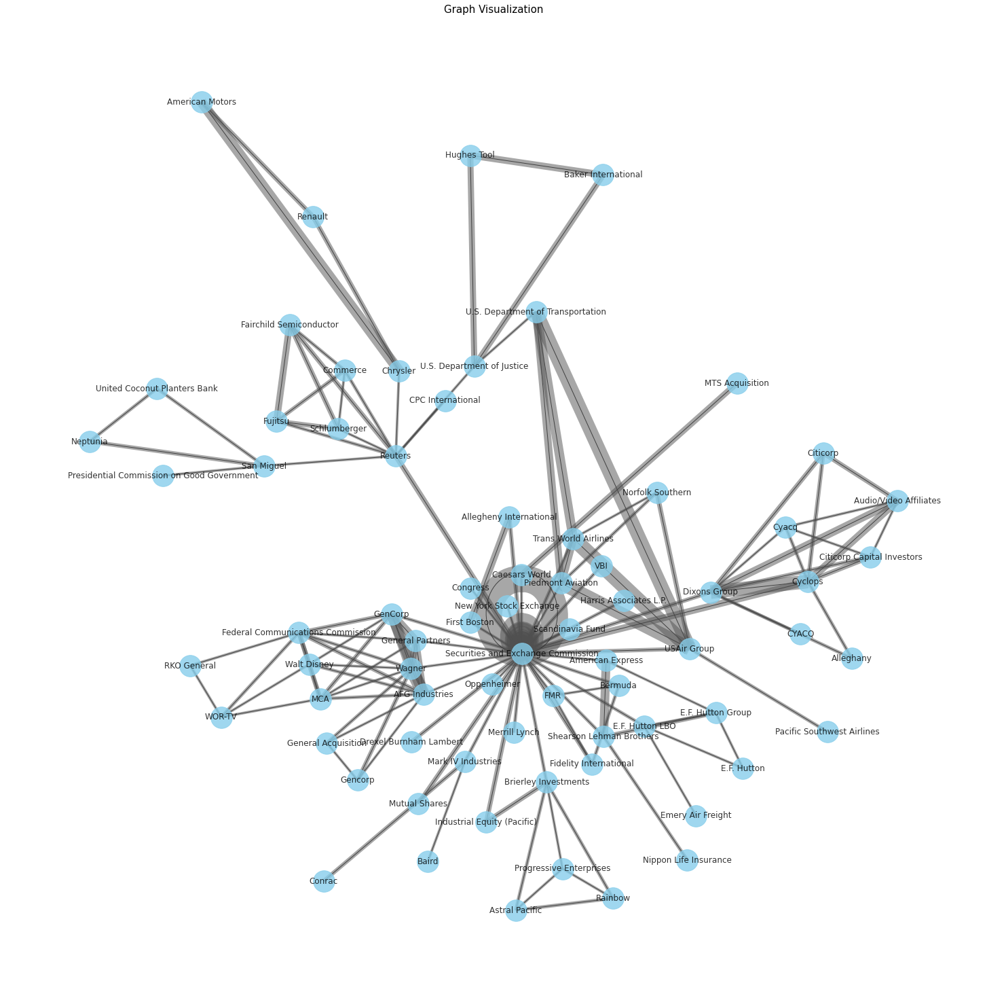

In [ ]:
import matplotlib.pyplot as plt
# identify the greatest component (connected subgraph)
# and plot only that one
giant_component = sorted(nx.connected_components(graph), key=len, reverse=True)
graph = graph.subgraph(giant_component[0])

pos = nx.kamada_kawai_layout(graph, weight='weight')
# pos = nx.fruchterman_reingold_layout(graph, weight='weight')
# pos = nx.circular_layout(graph)

_ = plt.figure(figsize=(20, 20))
nx.draw(graph, pos, 
        node_size=1000, 
        node_color='skyblue',
        alpha=0.8,
        with_labels = True)
plt.title('Graph Visualization', size=15)

for (node1,node2,data) in graph.edges(data=True):
    width = data['weight'] 
    _ = nx.draw_networkx_edges(graph,pos,
                               edgelist=[(node1, node2)],
                               width=width,
                               edge_color='#505050',
                               alpha=0.5)

plt.show()

#**Relation Extraction**

##**Relation Extraction by Phrase Matching**

In [ ]:
!python -m spacy download en_core_web_lg

In [ ]:
import en_core_web_lg
nlp = en_core_web_lg.load()

In [ ]:
# need to re-create the entity ruler after reloading nlp
# because new entity type 'GOV' needs to be added to nlp.vocab
entity_ruler = EntityRuler(nlp, patterns=patterns, overwrite_ents=True)

In [ ]:
reset_pipeline(nlp, ['entity_ruler', 'norm_entities', 'merge_entities', 
                     'init_coref', 'alias_resolver', 'name_resolver', 
                     'norm_names'])

Model: core_web_lg, Language: en
('tok2vec', <spacy.pipeline.tok2vec.Tok2Vec object at 0x7f8d2cffa950>)
('tagger', <spacy.pipeline.tagger.Tagger object at 0x7f8d2cf9e890>)
('parser', <spacy.pipeline.dep_parser.DependencyParser object at 0x7f8d2d2263d0>)
('ner', <spacy.pipeline.ner.EntityRecognizer object at 0x7f8d2d1d1520>)
('attribute_ruler', <spacy.pipeline.attributeruler.AttributeRuler object at 0x7f8d2cec7c30>)
('lemmatizer', <spacy.lang.en.lemmatizer.EnglishLemmatizer object at 0x7f8d2cec8820>)
('entity_ruler', <spacy.pipeline.entityruler.EntityRuler object at 0x7f8d2d12ea50>)
('norm_entities', <function norm_entities at 0x7f8d387d1b90>)
('merge_entities', <function merge_entities at 0x7f8d3a340c20>)
('init_coref', <function init_coref at 0x7f8d38699680>)
('alias_resolver', <function alias_resolver at 0x7f8d37677b90>)
('name_resolver', <function name_resolver at 0x7f8d375d8ef0>)
('norm_names', <function norm_names at 0x7f8d375a0a70>)


In [ ]:
text = """Fujitsu plans to acquire 80% of Fairchild Corp, an industrial unit of Schlumberger."""
text = re.sub('\s+', ' ', text).strip()

In [ ]:
doc = nlp(text)

displacy.render(doc, style='ent', jupyter=True)

In [ ]:
## We could find the relations in this sentence by searching for patterns like these:
## ORG {optional words, not ORG} acquire {optional words, not ORG} ORG
## ORG {optional words, not ORG} unit of {optional words, not ORG} ORG

from spacy.matcher import Matcher

matcher = Matcher(nlp.vocab)

acq_synonyms = ['acquire', 'buy', 'purchase']
pattern = [{'_': {'ref_t': 'ORG'}}, # subject
           {'_': {'ref_t': {'NOT_IN': ['ORG']}}, 'OP': '*'},
           {'POS': 'VERB', 'LEMMA': {'IN': acq_synonyms}},
           {'_': {'ref_t': {'NOT_IN': ['ORG']}}, 'OP': '*'},
           {'_': {'ref_t': 'ORG'}}] # object
matcher.add('acquires', [pattern])


subs_synonyms = ['subsidiary', 'unit']
pattern = [{'_': {'ref_t': 'ORG'}}, # subject
           {'_': {'ref_t': {'NOT_IN': ['ORG']}}, 
            'POS': {'NOT_IN': ['VERB']}, 'OP': '*'},
           {'LOWER': {'IN': subs_synonyms}}, {'TEXT': 'of'},
           {'_': {'ref_t': {'NOT_IN': ['ORG']}}, 
            'POS': {'NOT_IN': ['VERB']}, 'OP': '*'},
           {'_': {'ref_t': 'ORG'}}] # object
matcher.add('subsidiary-of', [pattern])

In [ ]:
## it takes a processed Doc object and a matcher and transforms all matches to subject-predicate-object triples:
def extract_rel_match(doc, matcher):
    for sent in doc.sents:
        for match_id, start, end in matcher(sent):
            span = sent[start:end]  # matched span
            pred = nlp.vocab.strings[match_id] # rule name
            subj, obj = span[0], span[-1]
            if pred.startswith('rev-'): # reversed relation
                subj, obj = obj, subj
                pred = pred[4:]
            yield ((subj._.ref_n, subj._.ref_t), pred, 
                   (obj._.ref_n, obj._.ref_t))

In [ ]:
text = """Fujitsu plans to acquire 80% of Fairchild Corp, an industrial unit of Schlumberger."""

text = re.sub('\s+', ' ', text) ###
doc = nlp(text)
print(*extract_rel_match(doc, matcher), sep='\n')

(('Fujitsu', 'ORG'), 'acquires', ('Fairchild', 'ORG'))
(('Fairchild', 'ORG'), 'subsidiary-of', ('Schlumberger', 'ORG'))


In [ ]:
## if it appear in reverse order e.g. object-predicate-subject triples.
pattern = [{'_': {'ref_t': 'ORG'}}, # subject
           {'LOWER': {'IN': subs_synonyms}}, # predicate
           {'_': {'ref_t': 'ORG'}}] # object
matcher.add('rev-subsidiary-of', [pattern])

In [ ]:
text = """Fujitsu plans to acquire 80% of Fairchild Corp, an industrial unit 
of Schlumberger. The Schlumberger unit Fairchild Corp received an offer."""

text = re.sub('\s+', ' ', text) ###
doc = nlp(text)
print(*extract_rel_match(doc, matcher), sep='\n')

(('Fujitsu', 'ORG'), 'acquires', ('Fairchild', 'ORG'))
(('Fairchild', 'ORG'), 'subsidiary-of', ('Schlumberger', 'ORG'))
(('Fairchild', 'ORG'), 'subsidiary-of', ('Schlumberger', 'ORG'))


In [ ]:
## not working for passive clause
text = "Fairchild Corp was acquired by Fujitsu."
print(*extract_rel_match(nlp(text), matcher), sep='\n')

(('Fairchild', 'ORG'), 'acquires', ('Fujitsu', 'ORG'))


In [ ]:
## not working for different syntactical structure
text = "Fujitsu, a competitor of NEC, acquired Fairchild Corp."
print(*extract_rel_match(nlp(text), matcher), sep='\n')

(('NEC', 'ORG'), 'acquires', ('Fairchild', 'ORG'))


In [ ]:
## remove as not getting correct result
if matcher.has_key("acquires"): 
    matcher.remove("acquires")

##**Relation Extraction using Dependency Trees**

In [ ]:
reset_pipeline(nlp, ['entity_ruler', 'norm_entities', 'merge_entities', 
                     'init_coref', 'alias_resolver', 'name_resolver',
                     'norm_names'])

Model: core_web_lg, Language: en
('tok2vec', <spacy.pipeline.tok2vec.Tok2Vec object at 0x7f8d2cffa950>)
('tagger', <spacy.pipeline.tagger.Tagger object at 0x7f8d2cf9e890>)
('parser', <spacy.pipeline.dep_parser.DependencyParser object at 0x7f8d2d2263d0>)
('ner', <spacy.pipeline.ner.EntityRecognizer object at 0x7f8d2d1d1520>)
('attribute_ruler', <spacy.pipeline.attributeruler.AttributeRuler object at 0x7f8d2cec7c30>)
('lemmatizer', <spacy.lang.en.lemmatizer.EnglishLemmatizer object at 0x7f8d2cec8820>)
('entity_ruler', <spacy.pipeline.entityruler.EntityRuler object at 0x7f8d2cf64050>)
('norm_entities', <function norm_entities at 0x7f8d387d1b90>)
('merge_entities', <function merge_entities at 0x7f8d3a340c20>)
('init_coref', <function init_coref at 0x7f8d38699680>)
('alias_resolver', <function alias_resolver at 0x7f8d37677b90>)
('name_resolver', <function name_resolver at 0x7f8d375d8ef0>)
('norm_names', <function norm_names at 0x7f8d375a0a70>)


In [ ]:
text = "Fujitsu, a competitor of NEC, acquired Fairchild Corp."
doc = nlp(text)
displacy.render(doc, style='dep', jupyter=True, 
                options={'compact': False, 'distance': 100})

In [ ]:
text = "Fairchild Corp was acquired by Fujitsu."
doc = nlp(text)
displacy.render(doc, style='dep', jupyter=True, options={'compact': False, 'distance': 100})

In [ ]:
# Actually we search for the shortest path between the
# subject running through our predicate (verb) to the object.
# subject and object are organizations in our examples.

# Here are the three helper functions:
# - bfs: breadth first searching the closest subject/object 
# - is_passive: checks if noun or verb is in passive form
# - find_subj: searches left part of tree for subject
# - find_obj: searches right part of tree for object

from collections import deque

def bfs(root, ent_type, deps, first_dep_only=False):
    """Return first child of root (included) that matches
    ent_type and dependency list by breadth first search.
    Search stops after first dependency match if first_dep_only
    (used for subject search - do not "jump" over subjects)"""
    to_visit = deque([root]) # queue for bfs

    while len(to_visit) > 0:
        child = to_visit.popleft()
        # print("child", child, child.dep_)
        if child.dep_ in deps:
            if child._.ref_t == ent_type:
                return child
            elif first_dep_only: # first match (subjects)
                return None
        elif child.dep_ == 'compound' and \
             child.head.dep_ in deps and \
             child._.ref_t == ent_type: # check if contained in compound
            return child
        to_visit.extend(list(child.children))
    return None

def is_passive(token):
    if token.dep_.endswith('pass'): # noun
        return True
    for left in token.lefts: # verb
        if left.dep_ == 'auxpass':
            return True
    return False

def find_subj(pred, ent_type, passive):
    """Find closest subject in predicates left subtree or
    predicates parent's left subtree (recursive).
    Has a filter on organizations."""
    for left in pred.lefts:
        if passive: # if pred is passive, search for passive subject
            subj = bfs(left, ent_type, ['nsubjpass', 'nsubj:pass'], True)
        else:
            subj = bfs(left, ent_type, ['nsubj'], True)
        if subj is not None: # found it!
            return subj
    if pred.head != pred and not is_passive(pred): 
        return find_subj(pred.head, ent_type, passive) # climb up left subtree
    else:
        return None

def find_obj(pred, ent_type, excl_prepos):
    """Find closest object in predicates right subtree.
    Skip prepositional objects if the preposition is in exclude list.
    Has a filter on organizations."""
    for right in pred.rights:
        obj = bfs(right, ent_type, ['dobj', 'pobj', 'iobj', 'obj', 'obl'])
        if obj is not None:
            if obj.dep_ == 'pobj' and obj.head.lemma_.lower() in excl_prepos: # check preposition
                continue
            return obj
    return None

In [ ]:
## implements a rule to identify verb-based relations (like acquires) based on the dependencies

def extract_rel_dep(doc, pred_name, pred_synonyms, excl_prepos=[]):
    for token in doc:
        if token.pos_ == 'VERB' and token.lemma_ in pred_synonyms:
            pred = token
            passive = is_passive(pred)
            subj = find_subj(pred, 'ORG', passive)
            if subj is not None:
                obj = find_obj(pred, 'ORG', excl_prepos)
                if obj is not None:
                    if passive: # switch roles
                        obj, subj = subj, obj
                    yield ((subj._.ref_n, subj._.ref_t), pred_name, 
                           (obj._.ref_n, obj._.ref_t))

In [ ]:
text = """Fujitsu said that Schlumberger Ltd has arranged 
to sell its stake in Fairchild Inc."""
doc = nlp(text)
print(*extract_rel_dep(doc, 'sells', ['sell']), sep='\n')

(('Schlumberger', 'ORG'), 'sells', ('Fairchild', 'ORG'))


In [ ]:
text = "Schlumberger Ltd has arranged to sell to Fujitsu its stake in Fairchild Inc."
doc = nlp(text)
print(*extract_rel_dep(doc, 'sells', ['sell']), sep='\n')
displacy.render(doc, style='dep', jupyter=True, options={'compact': False, 'distance': 80})

(('Schlumberger', 'ORG'), 'sells', ('Fujitsu', 'ORG'))


In [ ]:
print("A:", *extract_rel_dep(doc, 'sells', ['sell']))
print("B:", *extract_rel_dep(doc, 'sells', ['sell'], ['to', 'from']))

A: (('Schlumberger', 'ORG'), 'sells', ('Fujitsu', 'ORG'))
B:


In [ ]:
texts = [ 
     "Fairchild Corp was bought by Fujitsu.", # 1
     "Fujitsu, a competitor of NEC Co, acquired Fairchild Inc.", # 2
     "Fujitsu is expanding." + 
     "The company made an offer to acquire 80% of Fairchild Inc.", # 3
     "Fujitsu plans to acquire 80% of Fairchild Corp.", # 4
     "Fujitsu plans not to acquire Fairchild Corp.", # 5
     "The competition forced Fujitsu to aquire Fairchild Corp." # 6
]

acq_synonyms = ['acquire', 'buy', 'purchase']
for i, text in enumerate(texts):
    doc = nlp(text)
    rels = extract_rel_dep(doc, 'acquires', acq_synonyms, ['to', 'from'])
    print(f'{i+1}:', *rels)

1: (('Fujitsu', 'ORG'), 'acquires', ('Fairchild', 'ORG'))
2: (('Fujitsu', 'ORG'), 'acquires', ('Fairchild', 'ORG'))
3:
4: (('Fujitsu', 'ORG'), 'acquires', ('Fairchild', 'ORG'))
5: (('Fujitsu', 'ORG'), 'acquires', ('Fairchild', 'ORG'))
6:


#**Knowledge Graph**

In [ ]:
if spacy.prefer_gpu():
    print("Working on GPU.")
else:
    print("No GPU found, working on CPU.")

nlp = en_core_web_lg.load()

No GPU found, working on CPU.


In [ ]:
# need to re-create the entity ruler after reloading nlp
# because new entity type 'GOV' needs to be added to nlp.vocab
entity_ruler = EntityRuler(nlp, patterns=patterns, overwrite_ents=True)

In [ ]:
pipes = ['entity_ruler', 'norm_entities', 'merge_entities',
         'init_coref', 'alias_resolver', 'name_resolver', 
         'norm_names']
for pipe in pipes:
    nlp.add_pipe(pipe)

In [ ]:
# recreate matcher - same definition as above for these rules
matcher = Matcher(nlp.vocab)

subs_synonyms = ['subsidiary', 'unit']
pattern = [{'_': {'ref_t': 'ORG'}}, # subject
           {'_': {'ref_t': {'NOT_IN': ['ORG']}}, 'POS': {'NOT_IN': ['VERB']}, 'OP': '*'},
           {'LOWER': {'IN': subs_synonyms}}, # predicate
           {'TEXT': 'of'},
           {'_': {'ref_t': {'NOT_IN': ['ORG']}}, 'POS': {'NOT_IN': ['VERB']}, 'OP': '*'},
           {'_': {'ref_t': 'ORG'}}] # object
matcher.add('subsidiary-of', [pattern])

pattern = [{'_': {'ref_t': 'ORG'}}, # subject
           {'POS': 'PART', 'OP': '?'},
           {'LOWER': {'IN': subs_synonyms}}, # predicate
           {'_': {'ref_t': 'ORG'}}] # object
matcher.add('rev-subsidiary-of', [pattern])

In [ ]:
ceo_synonyms = ['chairman', 'president', 'director', 'ceo', 'executive']
pattern = [{'ENT_TYPE': 'PERSON'},
           {'ENT_TYPE': {'NOT_IN': ['ORG', 'PERSON']}, 'OP': '*'}, 
           {'LOWER': {'IN': ceo_synonyms}}, {'TEXT': 'of'},
           {'ENT_TYPE': {'NOT_IN': ['ORG', 'PERSON']}, 'OP': '*'}, 
           {'ENT_TYPE': 'ORG'}] 
matcher.add('executive-of', [pattern])

pattern = [{'ENT_TYPE': 'ORG'}, 
           {'LOWER': {'IN': ceo_synonyms}},
           {'ENT_TYPE': 'PERSON'}] 
matcher.add('rev-executive-of', [pattern])

In [ ]:
def extract_rels(doc):
    yield from extract_rel_match(doc, matcher)
    yield from extract_rel_dep(doc, 'acquires', acq_synonyms, ['to', 'from'])
    yield from extract_rel_dep(doc, 'sells', ['sell'], ['to', 'from'])

##**Testing Relationship Extraction**

In [ ]:
import textwrap

text = """Allied-Signal Inc and Schlumberger Ltd jointly announced 
that Schlumberger had acquired Allied-Signal's unit Neptune International. 
"""
#text = df.text.loc[19975]

text = re.sub(r'\s+', ' ', text).strip()
print(*textwrap.wrap(text, 100), sep='\n')
print()
doc = nlp(text, disable='entity_ruler')
#displacy.render(doc, style='ent')
print(*extract_rels(doc), sep='\n')
displacy.render(doc, style='dep', jupyter=True, options={'compact': False, 'distance': 100})

Allied-Signal Inc and Schlumberger Ltd jointly announced that Schlumberger had acquired Allied-
Signal's unit Neptune International.

(('Neptune International', 'ORG'), 'subsidiary-of', ('Allied-Signal', 'ORG'))


##**Extraction of Entities and Relations and Creation of Gephi-File**

In [ ]:
from math import ceil

batch_size = 20
batches = ceil(len(df) / batch_size) ###

rels = []
for i in tqdm(range(0, len(df), batch_size), total=batches):
    docs = nlp.pipe(df['text'][i:i+batch_size])
    for j, doc in enumerate(docs):
        rels.extend([(df.index[i+j], *r) for r in extract_rels(doc)])

100%|██████████| 108/108 [00:49<00:00,  2.17it/s]


In [ ]:
# unpack subject and object 
rels = [(a_id, *subj, pred, *obj) for (a_id, subj, pred, obj) in rels]

# create data frame
rel_df = pd.DataFrame.from_records(rels, columns=('article_id', 'subj', 'subj_type', 'pred', 'obj', 'obj_type'))

# false positives: subject cannot be object
rel_df = rel_df.query('subj != obj')

# filter entities that were not correctly detected
# tokenizer produces "-owned XYZ company"
rel_df = rel_df[~rel_df['subj'].str.startswith('-own')]
rel_df = rel_df[~rel_df['obj'].str.startswith('-own')]

# drop duplicate relations (within an article)
rel_df = rel_df.drop_duplicates()

# aggregate to produce one record per relation
rel_df['article_id'] = rel_df['article_id'].map(lambda a: [a])
rel_df = rel_df.groupby(['subj', 'subj_type', 'pred', 'obj', 'obj_type'])['article_id'] \
                 .agg(['count', 'sum']) \
                 .rename(columns={'count': 'freq', 'sum': 'articles'}) \
                 .reset_index().sort_values('freq', ascending=False)

rel_df['articles'] = rel_df['articles'].map(lambda lst: ','.join(list(set([str(a) for a in lst]))))
rel_df.head(10)

,subj,subj_type,pred,obj,obj_type,freq,articles
812,Trans World Airlines,ORG,acquires,USAir Group,ORG,6,"7650,2950,3013,1836,1862,5750"
233,Dart Group,ORG,acquires,Supermarkets General,ORG,5,"3912,5352,9230,3242,3313"
739,Samuel Heyman,PERSON,executive-of,GAF,ORG,4,"11661,11504,16513,15063"
757,Shearson Lehman Brothers,ORG,subsidiary-of,American Express,ORG,4,"6944,2543,2768,7024"
161,Chrysler,ORG,acquires,American Motors,ORG,4,"3198,3056,3795,7796"
336,Fujitsu,ORG,acquires,Fairchild Semiconductor,ORG,3,"5643,5690,5808"
552,Minories Finance Limited,ORG,subsidiary-of,Bank of England,ORG,3,"12053,12068,12339"
142,Carl Lindner,PERSON,executive-of,American Financial,ORG,3,"11074,3547,6157"
141,Carl Icahn,PERSON,executive-of,Trans World Airlines,ORG,3,"1836,2799,3095"
719,Ronald Perelman,PERSON,executive-of,Revlon Group,ORG,3,"18577,12049,8974"


In [ ]:
rel_df['pred'].value_counts()

acquires         507
executive-of     154
sells            133
subsidiary-of     83
Name: pred, dtype: int64

In [ ]:
# try searching for a specific entity
search = "Trans World"
rel_df[(rel_df.subj.str.lower().str.contains(search.lower()) | 
        rel_df.obj.str.lower().str.contains(search.lower()))]

,subj,subj_type,pred,obj,obj_type,freq,articles
812,Trans World Airlines,ORG,acquires,USAir Group,ORG,6,"7650,2950,3013,1836,1862,5750"
141,Carl Icahn,PERSON,executive-of,Trans World Airlines,ORG,3,"1836,2799,3095"
813,Trans World Airlines,ORG,sells,USAir Group,ORG,1,9487


In [ ]:
# in fact, TWA acquires and sells parts of USAir according to the messages
# look at a specific article
text = df['text'][9487]
print(*textwrap.wrap(text, 80), sep='\n')

Trans World Airlines Inc sold four million shares it held in USAir Group Inc,
Wall Street sources said. The sources said the buyers are believed to be a group
of institutions. Bear Stearns handled the trade. It crossed the four million
shares at 45, off 1/8. Bear Stearns would not comment on buyers or sellers.
USAir and TWA had no immediate comment. USAir later said it did not buy the
stock. A company spokesman would not comment further. TWA earlier this month
reported holding slightly more than four million shares, or about 15 % of USAir.
It had also proposed a takeover of USAir, which at the time was negotiating its
proposed merger with Piedmont Aviation Inc. On March 16, TWA withdrew its bid,
saying it did not intend to seek control of USAir Group or to acquire more of
its stock at the time. TWA also said in the filing with the Securities and
Exchange Commission that its chairman, Carl Icahn is the target of an SEC probe
of alleged violations of securities laws. In its filings with 

## **Visualise Knowledge Graph**

In [ ]:
import networkx as nx
from networkx import MultiDiGraph

graph = MultiDiGraph()
for i, row in rel_df.iterrows():
    graph.add_node(row['subj'], Type=row['subj_type'])
    graph.add_node(row['obj'], Type=row['obj_type'])
    _ = graph.add_edge(row['subj'], row['obj'], 
                   Articles=row['articles'], Rel=row['pred'])
   
nx.readwrite.write_gexf(graph, 'knowledge_graph.gexf', encoding='utf-8', 
                         prettyprint=True, version='1.2draft')

In [210]:
import matplotlib.pyplot as plt

plt.figure(figsize=(100,100))
pos = nx.spring_layout(graph)

nx.draw(graph, pos, with_labels=True, connectionstyle='arc3, rad = 0.1')
##nx.draw(graph, pos)
edge_labels=dict([
                  ((u,v,),d['Rel'])
             for u,v,d in graph.edges(data=True)
             ])



nx.draw_networkx_edge_labels(graph, pos, edge_labels=edge_labels, label_pos=0.3, font_size=10 , font_color='red')


plt.show()